In [30]:
import pandas as pd
import torch
import matplotlib.pyplot as plt

/home/anson/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


In [5]:
df = pd.read_csv('../data/processed/qm9_clean.csv')
words = df['smiles'].astype(str).tolist()

In [ ]:
words[:100]

['C',
 'N',
 'O',
 'C#C',
 'C#N',
 'C=O',
 'CC',
 'CO',
 'CC#C',
 'CC#N',
 'CC=O',
 'NC=O',
 'CCC',
 'CCO',
 'COC',
 'C1CC1',
 'C1CO1',
 'CC(C)=O',
 'CC(N)=O',
 'NC(N)=O',
 'CC(C)C',
 'CC(C)O',
 'C#CC#C',
 'C#CC#N',
 'N#CC#N',
 'O=CC#C',
 'O=CC#N',
 'O=CC=O',
 'CC#CC',
 'CCC#C',
 'CCC#N',
 'NCC#N',
 'OCC#C',
 'OCC#N',
 'CCC=O',
 'CNC=O',
 'COC=O',
 'OCC=O',
 'CCCC',
 'CCCO',
 'CCOC',
 'OCCO',
 'CC1CC1',
 'CC1CO1',
 'CN1CC1',
 'OC1CC1',
 'C1CCC1',
 'C1COC1',
 'CC(C)=NO',
 'N1C=CC=C1',
 'N1C=CN=C1',
 'O1C=CC=C1',
 'O1C=CN=C1',
 'CC(C)(C)C',
 'CC(C)(C)O',
 'CC(=O)C#C',
 'CC(=O)C#N',
 'NC(=N)C#N',
 'NC(=O)C#C',
 'CC(=O)C=O',
 'NC(=N)C=O',
 'NC(=O)C=O',
 'CC(C)C#C',
 'CC(C)C#N',
 'CC(N)C#N',
 'CC(O)C#C',
 'CC(O)C#N',
 'CC(C)C=O',
 'CC(O)C=O',
 'CN(C)C=O',
 'CC(=O)CO',
 'CCC(C)=O',
 'CCC(N)=O',
 'CNC(C)=O',
 'CNC(N)=O',
 'COC(C)=N',
 'COC(C)=O',
 'COC(N)=O',
 'NC(=O)CO',
 '[NH3+]CC([O-])=O',
 'CC(C)CO',
 'CC(O)CO',
 'CCC(C)C',
 'CCC(C)O',
 'COC(C)C',
 'CC1(C)CC1',
 'CC1(C)CO1',
 'CC1(O)CC1',

In [8]:
len(words)

133885

In [9]:
min(len(w) for w in words)

1

In [10]:
max(len(w) for w in words)

28

In [ ]:
b = {}
for w in words:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        bigram = (ch1, ch2)
        b[bigram] = b.get(bigram, 0) + 1
        # print(ch1, ch2)

. C
C .
. N
N .
. O
O .
. C
C #
# C
C .
. C
C #
# N
N .
. C
C =
= O
O .
. C
C C
C .
. C
C O
O .
. C
C C
C #
# C
C .
. C
C C
C #
# N
N .
. C
C C
C =
= O
O .
. N
N C
C =
= O
O .
. C
C C
C C
C .
. C
C C
C O
O .
. C
C O
O C
C .
. C
C 1
1 C
C C
C 1
1 .
. C
C 1
1 C
C O
O 1
1 .
. C
C C
C (
( C
C )
) =
= O
O .
. C
C C
C (
( N
N )
) =
= O
O .
. N
N C
C (
( N
N )
) =
= O
O .
. C
C C
C (
( C
C )
) C
C .
. C
C C
C (
( C
C )
) O
O .
. C
C #
# C
C C
C #
# C
C .
. C
C #
# C
C C
C #
# N
N .
. N
N #
# C
C C
C #
# N
N .
. O
O =
= C
C C
C #
# C
C .
. O
O =
= C
C C
C #
# N
N .
. O
O =
= C
C C
C =
= O
O .
. C
C C
C #
# C
C C
C .
. C
C C
C C
C #
# C
C .
. C
C C
C C
C #
# N
N .
. N
N C
C C
C #
# N
N .
. O
O C
C C
C #
# C
C .
. O
O C
C C
C #
# N
N .
. C
C C
C C
C =
= O
O .
. C
C N
N C
C =
= O
O .
. C
C O
O C
C =
= O
O .
. O
O C
C C
C =
= O
O .
. C
C C
C C
C C
C .
. C
C C
C C
C O
O .
. C
C C
C O
O C
C .
. O
O C
C C
C O
O .
. C
C C
C 1
1 C
C C
C 1
1 .
. C
C C
C 1
1 C
C O
O 1
1 .
. C
C N
N 1
1 C
C C
C 1
1 .
. O


In [21]:
b.items()

dict_items([(('.', 'C'), 90405), (('C', '.'), 16125), (('.', 'N'), 12665), (('N', '.'), 14025), (('.', 'O'), 29620), (('O', '.'), 30137), (('C', '#'), 34476), (('#', 'C'), 22078), (('#', 'N'), 14949), (('C', '='), 42719), (('=', 'O'), 44881), (('C', 'C'), 241219), (('C', 'O'), 44370), (('N', 'C'), 38384), (('O', 'C'), 75351), (('C', '1'), 221555), (('1', 'C'), 96121), (('1', '.'), 41031), (('O', '1'), 14079), (('C', '('), 82754), (('(', 'C'), 59132), (('C', ')'), 31023), ((')', '='), 9875), (('(', 'N'), 8062), (('N', ')'), 14611), ((')', 'C'), 80697), ((')', 'O'), 10191), (('N', '#'), 2551), (('O', '='), 11443), (('=', 'C'), 69653), (('C', 'N'), 35321), (('N', '1'), 27421), (('=', 'N'), 29539), (('N', 'O'), 4231), (('N', '='), 18422), ((')', '('), 5075), (('(', '='), 25178), (('O', ')'), 48168), (('(', 'O'), 21379), (('N', '('), 3472), (('.', '['), 607), (('[', 'N'), 1875), (('N', 'H'), 1705), (('H', '3'), 662), (('3', '+'), 662), (('+', ']'), 1705), ((']', 'C'), 1141), (('(', '['), 13

In [24]:
sorted(b.items(), key = lambda kv: kv[1])


[(('4', '2'), 1),
 ((']', 'O'), 1),
 (('3', '3'), 2),
 (('N', '5'), 5),
 (('3', '['), 5),
 (('4', '3'), 7),
 (('1', '5'), 8),
 (('4', '1'), 10),
 (('5', 'O'), 10),
 (('2', '5'), 13),
 (('5', 'N'), 19),
 ((']', '['), 20),
 (('4', '='), 20),
 (('O', '['), 23),
 (('5', ')'), 24),
 (('2', '['), 25),
 (('4', '5'), 28),
 (('O', '4'), 30),
 (('C', 'H'), 34),
 (('H', '-'), 34),
 (('3', '5'), 34),
 ((']', 'N'), 38),
 ((']', '2'), 47),
 (('3', '2'), 56),
 (('5', '.'), 58),
 (('4', '('), 71),
 ((']', '='), 80),
 ((']', '('), 89),
 ((')', '['), 101),
 (('2', '2'), 112),
 (('C', '-'), 116),
 ((']', '.'), 128),
 (('5', 'C'), 131),
 (('1', '['), 145),
 (('[', 'C'), 150),
 (('C', '5'), 154),
 (('N', '['), 158),
 (('N', '-'), 170),
 ((']', '1'), 253),
 (('4', 'N'), 258),
 (('H', '+'), 266),
 ((')', 'F'), 277),
 (('N', '4'), 300),
 (('1', 'F'), 303),
 (('3', '1'), 315),
 (('4', 'O'), 319),
 (('4', ')'), 325),
 (('1', '4'), 349),
 (('=', '['), 400),
 (('3', '='), 510),
 (('F', '.'), 567),
 (('.', 'F'), 5

In [ ]:
#G
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
vocab_size = len(stoi)

N = torch.zeros((vocab_size, vocab_size), dtype=torch.int32)

# Fill the matrix 
for w in words:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        ix1 = stoi[ch1]
        ix2 = stoi[ch2]
        N[ix1, ix2] += 1

In [28]:
itos

{1: '#',
 2: '(',
 3: ')',
 4: '+',
 5: '-',
 6: '1',
 7: '2',
 8: '3',
 9: '4',
 10: '5',
 11: '=',
 12: 'C',
 13: 'F',
 14: 'H',
 15: 'N',
 16: 'O',
 17: '[',
 18: ']',
 0: '.'}

In [29]:
stoi

{'#': 1,
 '(': 2,
 ')': 3,
 '+': 4,
 '-': 5,
 '1': 6,
 '2': 7,
 '3': 8,
 '4': 9,
 '5': 10,
 '=': 11,
 'C': 12,
 'F': 13,
 'H': 14,
 'N': 15,
 'O': 16,
 '[': 17,
 ']': 18,
 '.': 0}

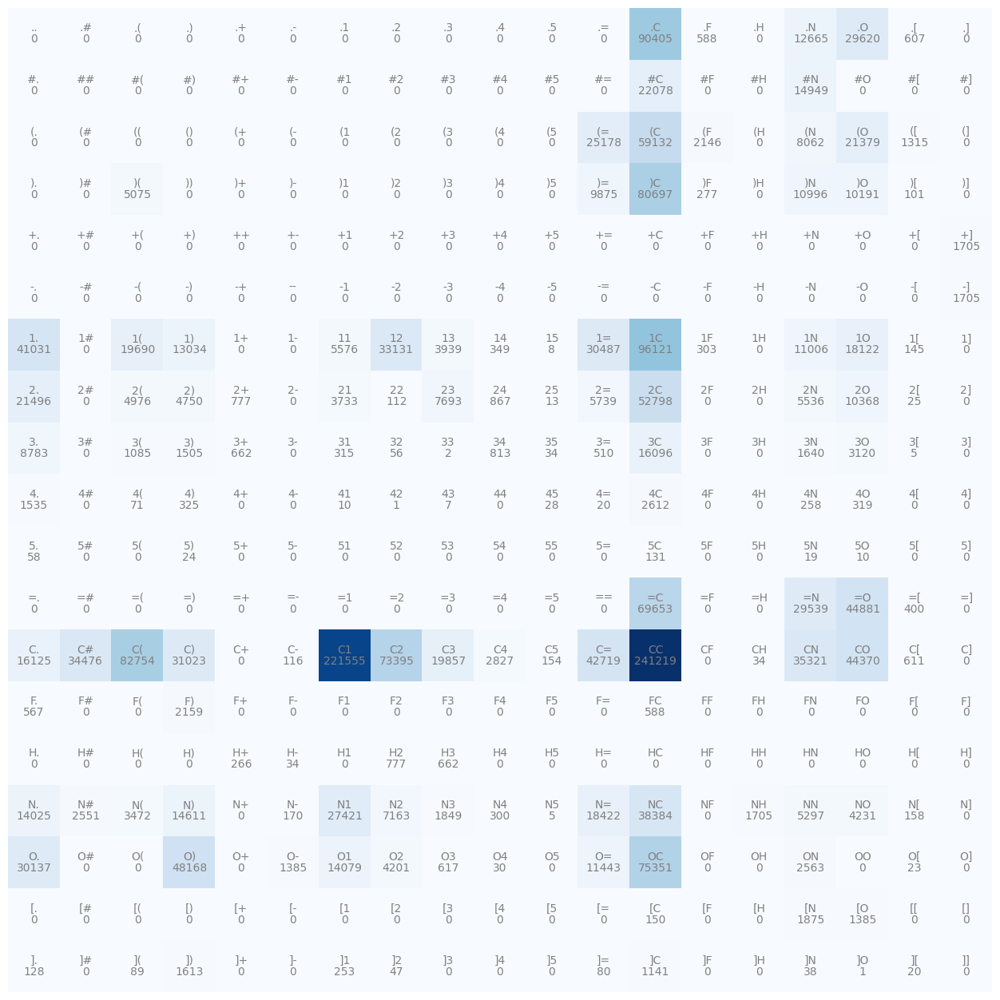

In [93]:
plt.figure(figsize=(16,16))
plt.imshow(N, cmap='Blues')
for i in range(19):
    for j in range(19):
        chstr = itos[i] + itos[j]
        plt.text(j, i, chstr, ha="center", va="bottom", color="gray")
        plt.text(j, i, N[i,j].item(), ha="center", va="top", color='gray')
plt.axis('off');
        

In [74]:
N[0]

tensor([    0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0, 90405,   588,     0, 12665, 29620,   607,     0],
       dtype=torch.int32)

In [80]:
P = (N+1).float()
P = P / P.sum(1, keepdim=True)
P

tensor([[7.4680e-06, 7.4680e-06, 7.4680e-06, 7.4680e-06, 7.4680e-06, 7.4680e-06,
         7.4680e-06, 7.4680e-06, 7.4680e-06, 7.4680e-06, 7.4680e-06, 7.4680e-06,
         6.7516e-01, 4.3987e-03, 7.4680e-06, 9.4590e-02, 2.2121e-01, 4.5406e-03,
         7.4680e-06],
        [2.6993e-05, 2.6993e-05, 2.6993e-05, 2.6993e-05, 2.6993e-05, 2.6993e-05,
         2.6993e-05, 2.6993e-05, 2.6993e-05, 2.6993e-05, 2.6993e-05, 2.6993e-05,
         5.9599e-01, 2.6993e-05, 2.6993e-05, 4.0355e-01, 2.6993e-05, 2.6993e-05,
         2.6993e-05],
        [8.5302e-06, 8.5302e-06, 8.5302e-06, 8.5302e-06, 8.5302e-06, 8.5302e-06,
         8.5302e-06, 8.5302e-06, 8.5302e-06, 8.5302e-06, 8.5302e-06, 2.1478e-01,
         5.0441e-01, 1.8314e-02, 8.5302e-06, 6.8779e-02, 1.8237e-01, 1.1226e-02,
         8.5302e-06],
        [8.5302e-06, 8.5302e-06, 4.3299e-02, 8.5302e-06, 8.5302e-06, 8.5302e-06,
         8.5302e-06, 8.5302e-06, 8.5302e-06, 8.5302e-06, 8.5302e-06, 8.4244e-02,
         6.8837e-01, 2.3714e-03, 8.5302e-06

In [76]:
P.shape

torch.Size([19, 19])

In [82]:
P.sum(1, keepdim=True).shape

torch.Size([19, 1])

In [77]:
g = torch.Generator().manual_seed(2148483647)
P = P[0]

ix = torch.multinomial(P, num_samples=1, replacement=True, generator=g).item()
print(f"The model picked the character: {itos[ix]}")

The model picked the character: C


In [78]:
itos[ix]

'C'

In [83]:
# Generate 10 molecules
g = torch.Generator().manual_seed(2147483647)

for i in range(20):
    out = []
    ix = 0 # Always start with the '.' token (index 0)
    
    while True:
        p = P[ix] # Grab the probability row for the current character
        
        # Sample the index of the next character
        ix = torch.multinomial(p, num_samples=1, replacement=True, generator=g).item()
        
        # If we sample '.', the molecule is finished
        if ix == 0:
            break
            
        out.append(itos[ix])
    
    print(''.join(out))

C1N=CC=OC=O)C1
O
C1=N2C1(=C1=O
OCCNC)N2C123C=C2C2COC1=C1(CNCC#C12(C1OCN
C1(C1)C1O
C11C#N=CC12C1CC=C#NNCC(F)CO1OCCC1OCN=O2CC)N1C#C2
O1)OC(O1C(OCCC(=OC=O
CC1CCO)C#C2C3O)CC1N1COC3CC2N11(O)OC2OC1
OCOC1C2
CO)N1=N(=C(NC2O
O=CO
CCC=NN)(=C=C(OCCCO)CC)C12C(=O)=O
C12C1
O)OC1C1(CC1CC2C(CCCCON)(C=C(F)CC12C1CC1
O)CCCC1O)CCO)N=C12CCN-]CCCC=O)C=O1C(C(=OCOC1COC#C)CCC
C(CCN
C(=OCO)NC(OC2CO1C23CCCCC(CC(CC2
C2NCCCC(=OCNC1C1(=O1=C1=O)CC2
N1)C(=N
N


In [57]:
ix = 0
while True:
    p = N[ix].float()
    p = p / p.sum()
    ix = torch.multinomial(p, num_samples=1, replacement=True, generator=g).item()
    print(itos[ix])
    if ix == 0:
        break

C
N
(
=
N
1
.


In [94]:
log_likelihood = 0.0
n = 0
for w in words:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        ix1 = stoi[ch1]
        ix2 =  stoi[ch2]
        prob = P[ix1, ix2]
        logprob = torch.log(prob)
        log_likelihood += logprob
        n+=1
        # print(f'{ch1}{ch2}: {prob:.4f} {logprob: .4f}')
print(f'{log_likelihood=}')   
nll = -log_likelihood
print(f'{nll=}')
print(f'{nll/n}')

log_likelihood=tensor(-3691958.5000)
nll=tensor(3691958.5000)
1.7003540992736816


In [95]:
# Test on an impossible molecule
test_w = "F#F"
test_chs = ['.'] + list(test_w) + ['.']
test_loss = 0.0
for ch1, ch2 in zip(test_chs, test_chs[1:]):
    p = P[stoi[ch1], stoi[ch2]]
    test_loss += -torch.log(p)
print(f"Loss for '{test_w}': {test_loss/len(test_w)}")

Loss for 'F#F': 8.609167098999023


In [107]:
# TRAINING set for bigtams
xs, ys = [], []

for w in words[:5]:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        ix1 = stoi[ch1]
        ix2 =  stoi[ch2]
        print(ch1, ch2)
        xs.append(ix1)
        ys.append(ix2)
        
xs = torch.tensor(xs)
ys = torch.tensor(ys)
        
        

. C
C .
. N
N .
. O
O .
. C
C #
# C
C .
. C
C #
# N
N .


In [108]:
xs

tensor([ 0, 12,  0, 15,  0, 16,  0, 12,  1, 12,  0, 12,  1, 15])

In [109]:
ys

tensor([12,  0, 15,  0, 16,  0, 12,  1, 12,  0, 12,  1, 15,  0])

In [114]:
import torch.nn.functional as F
xenc = F.one_hot(xs, num_classes=19).float()
xenc

tensor([[1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
         0.],
        [1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
         0.],
        [1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
         0.],
        [1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
         0.],
        [0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
         0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
         0.],
        [1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0

In [115]:
xenc.shape

torch.Size([14, 19])

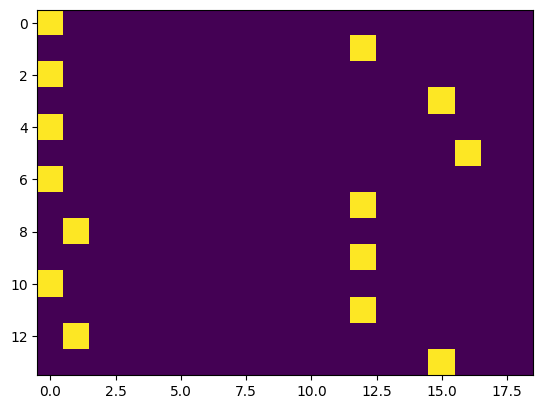

In [116]:
plt.imshow(xenc)

In [117]:
xenc.dtype

torch.float32

In [120]:
W = torch.randn((19,19))

In [121]:
xenc @ W

tensor([[-1.4242e+00,  1.5081e+00,  5.0986e-01,  4.8733e-01, -7.4834e-01,
          9.1549e-01,  7.3626e-02,  1.2117e+00,  1.5611e-03,  6.6947e-01,
          1.4621e+00, -2.0713e+00, -1.5052e-01,  2.4893e-01, -6.6766e-01,
         -2.5204e+00,  6.9482e-01,  6.0205e-01,  8.5151e-01],
        [-5.9305e-01,  2.0686e+00,  6.4195e-02, -2.3925e-01,  1.5452e+00,
          6.6711e-01, -1.4414e-02,  2.7488e-01,  3.3840e-01,  8.5082e-01,
         -7.2524e-01,  4.1660e-01,  3.3150e-01,  1.8882e+00, -9.2091e-01,
          8.0789e-01,  1.5106e-01, -2.4159e-01,  3.8499e-01],
        [-1.4242e+00,  1.5081e+00,  5.0986e-01,  4.8733e-01, -7.4834e-01,
          9.1549e-01,  7.3626e-02,  1.2117e+00,  1.5611e-03,  6.6947e-01,
          1.4621e+00, -2.0713e+00, -1.5052e-01,  2.4893e-01, -6.6766e-01,
         -2.5204e+00,  6.9482e-01,  6.0205e-01,  8.5151e-01],
        [-7.8172e-01, -3.5200e-01,  1.4597e+00,  5.8378e-01,  1.5296e-01,
          3.7716e-01,  1.3032e+00,  1.1475e+00, -1.8960e+00, -1.0170e+00,


In [124]:
logits = (xenc@W)
counts = logits.exp()
probs = counts / counts.sum(1, keepdim=True)
probs

tensor([[0.0076, 0.1422, 0.0524, 0.0513, 0.0149, 0.0786, 0.0339, 0.1058, 0.0315,
         0.0615, 0.1358, 0.0040, 0.0271, 0.0404, 0.0161, 0.0025, 0.0631, 0.0575,
         0.0738],
        [0.0141, 0.2026, 0.0273, 0.0202, 0.1200, 0.0499, 0.0252, 0.0337, 0.0359,
         0.0599, 0.0124, 0.0388, 0.0357, 0.1691, 0.0102, 0.0574, 0.0298, 0.0201,
         0.0376],
        [0.0076, 0.1422, 0.0524, 0.0513, 0.0149, 0.0786, 0.0339, 0.1058, 0.0315,
         0.0615, 0.1358, 0.0040, 0.0271, 0.0404, 0.0161, 0.0025, 0.0631, 0.0575,
         0.0738],
        [0.0134, 0.0206, 0.1263, 0.0526, 0.0342, 0.0428, 0.1080, 0.0924, 0.0044,
         0.0106, 0.0365, 0.0714, 0.0518, 0.2268, 0.0248, 0.0308, 0.0149, 0.0166,
         0.0212],
        [0.0076, 0.1422, 0.0524, 0.0513, 0.0149, 0.0786, 0.0339, 0.1058, 0.0315,
         0.0615, 0.1358, 0.0040, 0.0271, 0.0404, 0.0161, 0.0025, 0.0631, 0.0575,
         0.0738],
        [0.0827, 0.0893, 0.0259, 0.1997, 0.0217, 0.1472, 0.0687, 0.0632, 0.0099,
         0.0152, 0.

In [125]:
probs[0].sum()

tensor(1.)